In [25]:
import os
__import__('pysqlite3')
import sys
sys.modules['sqlite3'] = sys.modules.pop('pysqlite3')

from dotenv import load_dotenv, find_dotenv
_ = load_dotenv(find_dotenv()) # read local .env file

azure_openai_api_key = os.getenv("AZURE_OPENAI_API_KEY_4")
azure_openai_api_endpoint = os.getenv("AZURE_OPENAI_API_ENDPOINT_4")
deployment_name = os.getenv("AZURE_DEPLOYMENT_NAME_4")
hf_access_token = os.getenv("HUGGINGFACE_READ_ACCESS_TOKEN")

In [96]:
from langchain.chains import RetrievalQA
from langchain_openai import AzureChatOpenAI
from langchain.document_loaders import CSVLoader
from langchain_community.vectorstores import FAISS
from langchain.indexes import VectorstoreIndexCreator
from IPython.display import display, Markdown
from langchain_openai import AzureOpenAIEmbeddings

In [97]:
llm = AzureChatOpenAI(api_key=azure_openai_api_key,
                        api_version="2023-12-01-preview",
                        azure_endpoint=azure_openai_api_endpoint,
                        model=deployment_name,
                        temperature=0.0
                        )

In [8]:
import pandas as pd

df = pd.read_csv('../gutenberg_ebooks_modified.csv')
df.head(1)

,Unnamed: 0,index,Ebook ID,Author,Title,Credits,Summary,Language,Library of Congress Classification,Category,EBook-No.,Release Date,Most Recently Updated,Copyright Status,Downloads,Subjects
0,0,0,8600,"Zola, Émile, 1840-1902",L'Assommoir,"John Bickers, Dagny and David Widger","""L'Assommoir"" by Émile Zola is a novel written...",English,PQ: Language and Literatures: Romance literatu...,Text,8600,"Apr 27, 2006","Sep 15, 2022",Public domain in the USA.,455 downloads in the last 30 days.,"Domestic fiction, Married women -- Fiction, Pa..."


In [9]:
loader = CSVLoader(file_path='../gutenberg_ebooks_modified.csv', encoding='utf-8')
documents = loader.load()
print(len(documents))
documents[0]

2000


Document(metadata={'source': '../gutenberg_ebooks_modified.csv', 'row': 0}, page_content=': 0\nindex: 0\nEbook ID: 8600\nAuthor: Zola, Émile, 1840-1902\nTitle: L\'Assommoir\nCredits: John Bickers, Dagny and David Widger\nSummary: "L\'Assommoir" by Émile Zola is a novel written during the late 19th century, an era characterized by the realism movement in literature. The book explores the struggles of Gervaise, a laundress trying to build a life for herself and her children amidst the oppressive and often brutal conditions of working-class Paris. The story highlights themes of poverty, domestic strife, and the impact of alcoholism on individuals and families.  The opening of "L\'Assommoir" presents Gervaise in a state of despair, anxiously awaiting the return of Lantier, her partner, who has been increasingly unfaithful and irresponsible. The narrative depicts her emotional turmoil as she reflects on their meager living conditions and the struggles of single motherhood. Gervaise\'s obser

In [84]:
embeddings = AzureOpenAIEmbeddings(openai_api_key=azure_openai_api_key,
                                    azure_deployment='text-embedding-3-large',
                                    azure_endpoint=azure_openai_api_endpoint,
                                    openai_api_version="2023-05-15",
                                    chunk_size=512
)


# vectorstore = FAISS.from_documents(documents, embeddings)
# vectorstore

In [11]:
# vectorstore.save_local('faiss_vector_store')

In [85]:
vectorstore = FAISS.load_local('faiss_vector_store', embeddings=embeddings, allow_dangerous_deserialization=True)
retriever = vectorstore.as_retriever(search_type="similarity_score_threshold", search_kwargs={"score_threshold": 0.1})
docs = retriever.invoke('When did the author of "L\'assommoir" die?')
docs

[Document(metadata={'source': 'gutenberg_ebooks_modified.csv', 'row': 0}, page_content=': 0\nindex: 0\nEbook ID: 8600\nAuthor: Zola, Émile, 1840-1902\nTitle: L\'Assommoir\nCredits: John Bickers, Dagny and David Widger\nSummary: "L\'Assommoir" by Émile Zola is a novel written during the late 19th century, an era characterized by the realism movement in literature. The book explores the struggles of Gervaise, a laundress trying to build a life for herself and her children amidst the oppressive and often brutal conditions of working-class Paris. The story highlights themes of poverty, domestic strife, and the impact of alcoholism on individuals and families.  The opening of "L\'Assommoir" presents Gervaise in a state of despair, anxiously awaiting the return of Lantier, her partner, who has been increasingly unfaithful and irresponsible. The narrative depicts her emotional turmoil as she reflects on their meager living conditions and the struggles of single motherhood. Gervaise\'s observa

## Code adapté de cette [source](https://huggingface.co/learn/cookbook/en/rag_evaluation)

In [32]:
from huggingface_hub import InferenceClient
import json

# repo_id = "mistralai/Mixtral-8x7B-Instruct-v0.1"

# llm_client = InferenceClient(
#     model=repo_id,
#     timeout=120,
#     token=hf_access_token
# )


def call_llm(llm, prompt: str):
    response = llm.invoke(prompt)
    return response.content

call_llm(llm, "This is a test context")

'Got it! How can I assist you today?'

In [33]:
QA_generation_prompt = """
Your task is to write a factoid question and an answer given a context.
Your factoid question should be answerable with a specific, concise piece of factual information from the context.
Your factoid question should be formulated in the same style as questions users could ask in a search engine.
This means that your factoid question MUST NOT mention something like "according to the passage" or "context".

Provide your answer as follows:

Output:::
Factoid question: (your factoid question)
Answer: (your answer to the factoid question)

Now here is the context.

Context: {context}\n
Output:::"""

In [ ]:
import random
from tqdm import tqdm

N_GENERATIONS = 200

print(f"Generating {N_GENERATIONS} QA couples...")

outputs = []
for sampled_context in tqdm(random.sample(documents, N_GENERATIONS)):
    # Generate QA couple
    output_QA_couple = call_llm(llm, QA_generation_prompt.format(context=sampled_context.page_content))
    try:
        question = output_QA_couple.split("Factoid question: ")[-1].split("Answer: ")[0]
        answer = output_QA_couple.split("Answer: ")[-1]
        assert len(answer) < 300, "Answer is too long"
        outputs.append(
            {
                "context": sampled_context.page_content,
                "question": question,
                "answer": answer,
                "source_doc": sampled_context.metadata["source"],
            }
        )
    except:
        continue

Generating 200 QA couples...


100%|██████████| 200/200 [02:29<00:00,  1.34it/s]


In [46]:
question_groundedness_critique_prompt = """
You will be given a context and a question.
Your task is to provide a 'total rating' scoring how well one can answer the given question unambiguously with the given context.
Give your answer on a scale of 1 to 5, where 1 means that the question is not answerable at all given the context, and 5 means that the question is clearly and unambiguously answerable with the context.

Provide your answer as follows:

Answer:::
Evaluation: (your rationale for the rating, as a text)
Total rating: (your rating, as a number between 1 and 5)

You MUST provide values for 'Evaluation:' and 'Total rating:' in your answer.

Now here are the question and context.

Question: {question}\n
Context: {context}\n
Answer::: """

question_relevance_critique_prompt = """
You will be given a question.
Your task is to provide a 'total rating' representing how useful this question can be to machine learning developers building a solution to answer questions about books.
Give your answer on a scale of 1 to 5, where 1 means that the question is not useful at all, and 5 means that the question is extremely useful.

Provide your answer as follows:

Answer:::
Evaluation: (your rationale for the rating, as a text)
Total rating: (your rating, as a number between 1 and 5)

You MUST provide values for 'Evaluation:' and 'Total rating:' in your answer.

Now here is the question.

Question: {question}\n
Answer::: """

question_standalone_critique_prompt = """
You will be given a question.
Your task is to provide a 'total rating' representing how context-independant this question is.
Give your answer on a scale of 1 to 5, where 1 means that the question depends on additional information to be understood, and 5 means that the question makes sense by itself.
For instance, if the question refers to a particular setting, like 'in the context' or 'in the document', the rating must be 1.
The questions can contain obscure technical nouns or acronyms like Gradio, Hub, Hugging Face or Space and still be a 5: it must simply be clear to an operator with access to documentation what the question is about.

For instance, "What is the name of the checkpoint from which the ViT model is imported?" should receive a 1, since there is an implicit mention of a context, thus the question is not independant from the context.

Provide your answer as follows:

Answer:::
Evaluation: (your rationale for the rating, as a text)
Total rating: (your rating, as a number between 1 and 5)

You MUST provide values for 'Evaluation:' and 'Total rating:' in your answer.

Now here is the question.

Question: {question}\n
Answer::: """

In [47]:
print("Generating critique for each QA couple...")
for output in tqdm(outputs):
    evaluations = {
        "groundedness": call_llm(
            llm,
            question_groundedness_critique_prompt.format(context=output["context"], question=output["question"]),
        ),
        "relevance": call_llm(
            llm,
            question_relevance_critique_prompt.format(question=output["question"]),
        ),
        "standalone": call_llm(
            llm,
            question_standalone_critique_prompt.format(question=output["question"]),
        ),
    }
    try:
        for criterion, evaluation in evaluations.items():
            score, eval = (
                int(evaluation.split("Total rating: ")[-1].strip()),
                evaluation.split("Total rating: ")[-2].split("Evaluation: ")[1],
            )
            output.update(
                {
                    f"{criterion}_score": score,
                    f"{criterion}_eval": eval,
                }
            )
    except Exception as e:
        continue

Generating critique for each QA couple...


100%|██████████| 200/200 [13:12<00:00,  3.96s/it]


In [53]:
import pandas as pd
import datasets

pd.set_option("display.max_colwidth", None)

generated_questions_unfiltered = pd.DataFrame.from_dict(outputs)

print("Evaluation dataset before filtering:")
display(
    generated_questions_unfiltered[
        [
            "question",
            "answer",
            "groundedness_score",
            "relevance_score",
            "standalone_score",
        ]
    ]
)
generated_questions = generated_questions_unfiltered.loc[
    (generated_questions_unfiltered["groundedness_score"] >= 4)
    & (generated_questions_unfiltered["relevance_score"] >= 3)
    & (generated_questions_unfiltered["standalone_score"] >= 4)
]
print("============================================")
print("Final evaluation dataset:")
display(
    generated_questions[
        [
            "question",
            "answer",
            "groundedness_score",
            "relevance_score",
            "standalone_score",
        ]
    ]
)

eval_dataset = datasets.Dataset.from_pandas(generated_questions, split="train", preserve_index=False)

Evaluation dataset before filtering:


,question,answer,groundedness_score,relevance_score,standalone_score
0,"Who is the author of ""The Yellow Wallpaper""?\n\n",Charlotte Perkins Gilman,5,5,5
1,"Who is the author of ""King Richard III""?\n\n",William Shakespeare,5,5,5
2,"Who is the protagonist in the story ""The Wife"" by Anton Chekhov?\n\n",Pavel Andreitch,5,3,4
3,"What is the name of the ship that rescues Edward Prendick in ""The Island of Doctor Moreau""?\n\n",Ipecacuanha,5,4,2
4,"Who is the author of Symphony No. 5 in C minor, Opus 67?\n\n",Ludwig van Beethoven,5,1,5
...,...,...,...,...,...
195,"Who is the author of ""Beyond the City""?\n\n",Arthur Conan Doyle,5,5,5
196,"Who is the author of ""A Lady of Quality""?\n\n",Frances Hodgson Burnett,5,5,5
197,"Who is the author of ""The Gutenberg Webster's Unabridged Dictionary: Section A and B""?\n\n",Noah Webster,5,3,5
198,"Who wrote ""The Star-Spangled Banner""?\n\n",Francis Scott Key.,5,3,5


Final evaluation dataset:


,question,answer,groundedness_score,relevance_score,standalone_score
0,"Who is the author of ""The Yellow Wallpaper""?\n\n",Charlotte Perkins Gilman,5,5,5
1,"Who is the author of ""King Richard III""?\n\n",William Shakespeare,5,5,5
2,"Who is the protagonist in the story ""The Wife"" by Anton Chekhov?\n\n",Pavel Andreitch,5,3,4
6,"Who is the author of ""Episodes in Van Bibber's Life""?\n\n",Richard Harding Davis,5,4,5
7,"Who is the author of ""Songs for Parents""?\n\n",John Chipman Farrar,5,5,5
...,...,...,...,...,...
195,"Who is the author of ""Beyond the City""?\n\n",Arthur Conan Doyle,5,5,5
196,"Who is the author of ""A Lady of Quality""?\n\n",Frances Hodgson Burnett,5,5,5
197,"Who is the author of ""The Gutenberg Webster's Unabridged Dictionary: Section A and B""?\n\n",Noah Webster,5,3,5
198,"Who wrote ""The Star-Spangled Banner""?\n\n",Francis Scott Key.,5,3,5


<Axes: >

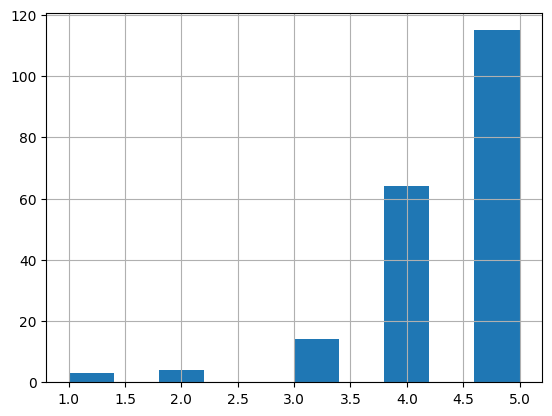

In [54]:
import matplotlib
generated_questions_unfiltered['relevance_score'].hist()

In [58]:
RAG_PROMPT_TEMPLATE = """
You are an assistant for question-answering tasks.
Use the following pieces of retrieved context to answer the question.
If you don't know the answer, just say that you don't know, but return the ebook id of the top document from the context if there is one.
<|user|>
Context:
{context}
---
Now here is the question you need to answer.

Question: {question}

<|assistant|>

Answer:
"""

In [99]:
from langchain_core.vectorstores import VectorStore
from typing import Optional, List, Tuple
from langchain.docstore.document import Document as LangchainDocument
from models import RAGAnswer
from langchain_core.runnables import RunnablePassthrough



def format_docs(docs):
    return "\n\n".join(doc.page_content for doc in docs)

def answer_with_rag(
    question: str,
    llm,
    knowledge_index,
    num_docs_final: int = 4,
) -> Tuple[str, List[LangchainDocument]]:
    """Answer a question using RAG with the given knowledge index."""

    # Gather documents with retriever
    relevant_docs = knowledge_index.similarity_search(query=question,
                                                      k=num_docs_final,
                                                      search_type="similarity_score_threshold",
                                                      search_kwargs={"score_threshold": 0.1})
    relevant_docs = [doc.page_content for doc in relevant_docs]  # keep only the text


    # Build the final prompt
    context = "\nExtracted documents:\n"
    context += "".join([f"Document {str(i)}:::\n" + doc for i, doc in enumerate(relevant_docs)])

    final_prompt = RAG_PROMPT_TEMPLATE.format(question=question, context=context)

    # Redact an answer

    structured_llm = llm.with_structured_output(RAGAnswer)
    # chain = ({
    #         "context": context,
    #         "question": RunnablePassthrough()
    #     }
    #     | RAG_PROMPT_TEMPLATE
    #     | structured_llm
    # )
    answer = structured_llm.invoke(final_prompt)

    return answer, relevant_docs

In [86]:
knowledge_index = FAISS.load_local('faiss_vector_store', embeddings=embeddings, allow_dangerous_deserialization=True)

In [109]:
from langchain_core.language_models import BaseChatModel


def run_rag_tests(
    eval_dataset: datasets.Dataset,
    llm,
    knowledge_index: VectorStore,
    output_file: str,
    verbose: Optional[bool] = True,
    test_settings: Optional[str] = None,  # To document the test settings used
):
    """Runs RAG tests on the given dataset and saves the results to the given output file."""
    try:  # load previous generations if they exist
        with open(output_file, "r") as f:
            outputs = json.load(f)
    except:
        outputs = []

    for example in tqdm(eval_dataset):
        question = example["question"]
        if question in [output["question"] for output in outputs]:
            continue

        answer, relevant_docs = answer_with_rag(question, llm, knowledge_index)
        if verbose:
            print("=======================================================")
            print(f"Question: {question}")
            print(f"Answer: {answer}")
            print(f'True answer: {example["answer"]}')
        result = {
            "question": question,
            "true_answer": example["answer"],
            "source_doc": example["source_doc"],
            "generated_answer": answer.answer,
            "retrieved_docs": [doc for doc in relevant_docs],
        }
        if test_settings:
            result["test_settings"] = test_settings
        outputs.append(result)

        with open(output_file, "w") as f:
            json.dump(outputs, f)

In [110]:
EVALUATION_PROMPT = """###Task Description:
An instruction (might include an Input inside it), a response to evaluate, a reference answer that gets a score of 5, and a score rubric representing a evaluation criteria are given.
1. Write a detailed feedback that assess the quality of the response strictly based on the given score rubric, not evaluating in general.
2. After writing a feedback, write a score that is an integer between 1 and 5. You should refer to the score rubric.
3. The output format should look as follows: \"Feedback: {{write a feedback for criteria}} [RESULT] {{an integer number between 1 and 5}}\"
4. Please do not generate any other opening, closing, and explanations. Be sure to include [RESULT] in your output.

###The instruction to evaluate:
{instruction}

###Response to evaluate:
{response}

###Reference Answer (Score 5):
{reference_answer}

###Score Rubrics:
[Is the response correct, accurate, and factual based on the reference answer?]
Score 1: The response is completely incorrect, inaccurate, and/or not factual.
Score 2: The response is mostly incorrect, inaccurate, and/or not factual.
Score 3: The response is somewhat correct, accurate, and/or factual.
Score 4: The response is mostly correct, accurate, and factual.
Score 5: The response is completely correct, accurate, and factual.

###Feedback:"""

from langchain.prompts.chat import (
    ChatPromptTemplate,
    HumanMessagePromptTemplate,
)
from langchain.schema import SystemMessage


evaluation_prompt_template = ChatPromptTemplate.from_messages(
    [
        SystemMessage(content="You are a fair evaluator language model."),
        HumanMessagePromptTemplate.from_template(EVALUATION_PROMPT),
    ]
)

In [111]:
from langchain.chat_models import ChatOpenAI

OPENAI_API_KEY = ""

eval_chat_model = llm
evaluator_name = "GPT4"


def evaluate_answers(
    answer_path: str,
    eval_chat_model,
    evaluator_name: str,
    evaluation_prompt_template: ChatPromptTemplate,
) -> None:
    """Evaluates generated answers. Modifies the given answer file in place for better checkpointing."""
    answers = []
    if os.path.isfile(answer_path):  # load previous generations if they exist
        answers = json.load(open(answer_path, "r"))

    for experiment in tqdm(answers):
        if f"eval_score_{evaluator_name}" in experiment:
            continue

        eval_prompt = evaluation_prompt_template.format_messages(
            instruction=experiment["question"],
            response=experiment["generated_answer"],
            reference_answer=experiment["true_answer"],
        )
        eval_result = eval_chat_model.invoke(eval_prompt)
        feedback, score = [item.strip() for item in eval_result.content.split("[RESULT]")]
        experiment[f"eval_score_{evaluator_name}"] = score
        experiment[f"eval_feedback_{evaluator_name}"] = feedback

        with open(answer_path, "w") as f:
            json.dump(answers, f)

In [108]:
if not os.path.exists("./output"):
    os.mkdir("./output")

for chunk_size in [200]:  # Add other chunk sizes (in tokens) as needed
    for embeddings in ["text-embedding-3-large"]:  # Add other embeddings as needed
        for rerank in [True, False]:
            settings_name = f"chunk:{chunk_size}_embeddings:{embeddings.replace('/', '~')}_rerank:{rerank}_reader-model:{type(llm)}"
            output_file_name = f"./output/rag_{settings_name}.json"

            print(f"Running evaluation for {settings_name}:")


            print("Running RAG...")
            run_rag_tests(
                eval_dataset=eval_dataset,
                llm=llm,
                knowledge_index=knowledge_index,
                output_file=output_file_name,
                verbose=False,
                test_settings=settings_name,
            )

            print("Running evaluation...")
            evaluate_answers(
                output_file_name,
                eval_chat_model,
                evaluator_name,
                evaluation_prompt_template,
            )

Running evaluation for chunk:200_embeddings:text-embedding-3-large_rerank:True_reader-model:<class 'langchain_openai.chat_models.azure.AzureChatOpenAI'>:
Running RAG...


  1%|          | 1/171 [00:01<04:02,  1.43s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

  1%|          | 2/171 [00:02<02:38,  1.06it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

  2%|▏         | 3/171 [00:02<02:33,  1.10it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

  2%|▏         | 4/171 [00:03<02:27,  1.13it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

  3%|▎         | 5/171 [00:04<02:14,  1.23it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

  4%|▎         | 6/171 [00:05<02:34,  1.07it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

  4%|▍         | 7/171 [00:06<02:37,  1.04it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

  5%|▍         | 8/171 [00:07<02:47,  1.03s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

  5%|▌         | 9/171 [00:08<02:31,  1.07it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

  6%|▌         | 10/171 [00:09<02:38,  1.02it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

  6%|▋         | 11/171 [00:10<02:50,  1.07s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

  7%|▋         | 12/171 [00:11<02:30,  1.06it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

  8%|▊         | 13/171 [00:12<02:52,  1.09s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

  8%|▊         | 14/171 [00:14<02:49,  1.08s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

  9%|▉         | 15/171 [00:14<02:32,  1.02it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

  9%|▉         | 16/171 [00:15<02:13,  1.16it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 10%|▉         | 17/171 [00:16<02:07,  1.21it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 11%|█         | 18/171 [00:17<02:16,  1.12it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 11%|█         | 19/171 [00:18<02:40,  1.06s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 12%|█▏        | 20/171 [00:19<02:41,  1.07s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 12%|█▏        | 21/171 [00:20<02:25,  1.03it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 13%|█▎        | 22/171 [00:21<02:11,  1.13it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 13%|█▎        | 23/171 [00:21<02:05,  1.18it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 14%|█▍        | 24/171 [00:22<02:05,  1.17it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 15%|█▍        | 25/171 [00:23<02:06,  1.15it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 15%|█▌        | 26/171 [00:24<02:05,  1.15it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 16%|█▌        | 27/171 [00:25<02:08,  1.12it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 16%|█▋        | 28/171 [00:26<02:13,  1.07it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 17%|█▋        | 29/171 [00:28<03:01,  1.28s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 18%|█▊        | 30/171 [00:29<02:52,  1.22s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 18%|█▊        | 31/171 [00:30<02:26,  1.05s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 19%|█▊        | 32/171 [00:31<02:11,  1.06it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 19%|█▉        | 33/171 [00:31<02:11,  1.05it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 20%|█▉        | 34/171 [00:32<02:05,  1.09it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 20%|██        | 35/171 [00:33<02:00,  1.13it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 21%|██        | 36/171 [00:34<02:03,  1.09it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 22%|██▏       | 37/171 [00:35<02:02,  1.10it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 22%|██▏       | 38/171 [00:36<02:13,  1.01s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 23%|██▎       | 39/171 [00:37<02:10,  1.01it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 23%|██▎       | 40/171 [00:38<02:00,  1.09it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 24%|██▍       | 41/171 [00:41<03:12,  1.48s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 25%|██▍       | 42/171 [00:42<02:44,  1.27s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 25%|██▌       | 43/171 [00:42<02:22,  1.11s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 26%|██▌       | 44/171 [00:43<02:11,  1.04s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 26%|██▋       | 45/171 [00:44<01:57,  1.07it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 27%|██▋       | 46/171 [00:48<03:48,  1.83s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 27%|██▋       | 47/171 [00:48<03:04,  1.49s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 28%|██▊       | 48/171 [00:49<02:36,  1.28s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 29%|██▊       | 49/171 [00:50<02:15,  1.11s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 29%|██▉       | 50/171 [00:51<02:05,  1.03s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 30%|██▉       | 51/171 [00:52<02:14,  1.12s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 30%|███       | 52/171 [00:53<02:11,  1.10s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 31%|███       | 53/171 [00:54<02:02,  1.04s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 32%|███▏      | 54/171 [00:56<02:16,  1.17s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 32%|███▏      | 55/171 [00:56<02:06,  1.09s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 33%|███▎      | 56/171 [00:58<02:08,  1.12s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 33%|███▎      | 57/171 [00:58<01:58,  1.04s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 34%|███▍      | 58/171 [00:59<01:47,  1.05it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 35%|███▍      | 59/171 [01:01<02:18,  1.23s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 35%|███▌      | 60/171 [01:02<02:12,  1.19s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 36%|███▌      | 61/171 [01:03<02:08,  1.17s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 36%|███▋      | 62/171 [01:04<02:00,  1.11s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 37%|███▋      | 63/171 [01:05<01:49,  1.01s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 37%|███▋      | 64/171 [01:06<01:45,  1.01it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 38%|███▊      | 65/171 [01:07<01:58,  1.12s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 39%|███▊      | 66/171 [01:09<01:58,  1.13s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 39%|███▉      | 67/171 [01:09<01:41,  1.02it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 40%|███▉      | 68/171 [01:10<01:34,  1.09it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 40%|████      | 69/171 [01:11<01:40,  1.01it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 41%|████      | 70/171 [01:12<01:29,  1.12it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 42%|████▏     | 71/171 [01:13<01:26,  1.16it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 42%|████▏     | 72/171 [01:13<01:24,  1.18it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 43%|████▎     | 73/171 [01:15<01:50,  1.13s/it]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 43%|████▎     | 74/171 [01:16<01:36,  1.00it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 44%|████▍     | 75/171 [01:17<01:33,  1.03it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 44%|████▍     | 76/171 [01:18<01:26,  1.10it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 45%|████▌     | 77/171 [01:18<01:21,  1.15it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 46%|████▌     | 78/171 [01:19<01:20,  1.15it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 46%|████▌     | 79/171 [01:20<01:16,  1.21it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 47%|████▋     | 80/171 [01:21<01:16,  1.19it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 47%|████▋     | 81/171 [01:22<01:16,  1.17it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 48%|████▊     | 82/171 [01:23<01:20,  1.10it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 49%|████▊     | 83/171 [01:24<01:18,  1.12it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 49%|████▉     | 84/171 [01:24<01:11,  1.22it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 50%|████▉     | 85/171 [01:25<01:09,  1.25it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

 50%|█████     | 86/171 [01:26<01:14,  1.15it/s]

<class 'list'>
[{'question': 'Who is the author of "The Yellow Wallpaper"?\n\n', 'true_answer': 'Charlotte Perkins Gilman', 'source_doc': '../gutenberg_ebooks_modified.csv', 'generated_answer': 'The author of "The Yellow Wallpaper" is Charlotte Perkins Gilman.', 'retrieved_docs': [': 1876\nindex: 1937\nEbook ID: 1952\nAuthor: Gilman, Charlotte Perkins, 1860-1935\nTitle: The Yellow Wallpaper\nCredits: An Anonymous Volunteer and David Widger\nSummary: "The Yellow Wallpaper" by Charlotte Perkins Gilman is a short story written in the late 19th century, often associated with the feminist literature genre. The narrative explores the themes of mental illness, gender roles, and the constraints faced by women in a patriarchal society. It follows the mental deterioration of a woman who is confined to a room by her husband, who is also her physician, under the pretense of helping her recover from what he diagnoses as temporary nervous depression.  The story is presented as a series of journal en

In [ ]:
import glob

outputs = []
for file in glob.glob("./output/*.json"):
    output = pd.DataFrame(json.load(open(file, "r")))
    output["settings"] = file
    outputs.append(output)
result = pd.concat(outputs)